# Bing

In [1]:
import numpy as np
np.eye(6)* 0.01

array([[0.01, 0.  , 0.  , 0.  , 0.  , 0.  ],
       [0.  , 0.01, 0.  , 0.  , 0.  , 0.  ],
       [0.  , 0.  , 0.01, 0.  , 0.  , 0.  ],
       [0.  , 0.  , 0.  , 0.01, 0.  , 0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.01, 0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.01]])

In [32]:
import math

# Define some constants and variables
G = 6.674e-11 # Gravitational constant
M = 6.39e23 # Mass of Mars
R = 3.39e6 # Radius of Mars
CD = 1.75 # Drag coefficient of the aeroshell
A = 15.8 # Cross-sectional area of the aeroshell
m = 1025 # Mass of the spacecraft
rho = 0.02 # Atmospheric density at entry interface
g0 = G * M / R**2 # Gravitational acceleration at entry interface
v0 = 5500 # Entry velocity
gamma0 = -11.5 * math.pi / 180 # Entry flight path angle
L_D = 0.24 # Lift-to-drag ratio of the aeroshell
bank0 = 0 # Initial bank angle
h0 = 125e3 # Entry altitude
dt = 0.3 # Time step
t = 0 # Current time
x = 0 # Downrange distance
h = h0 # Current altitude
v = v0 # Current velocity
gamma = gamma0 # Current flight path angle
psi = 0 # Current heading angle
bank = bank0 # Current bank angle
g = g0 # Current gravitational acceleration
q = 0.5 * rho * v**2 # Current dynamic pressure
D = CD * A * q / m # Current drag acceleration
L = L_D * D # Current lift acceleration
h_f = 10e3 # Final altitude

# # Model parameters
# M = 1.0 # Mass of projectile in kg
# g = 9.8 # Acceleration due to gravity (m/s^2)
# V = 80 # Initial velocity in m/s
# ang = 60.0 # Angle of initial velocity in degree
# Cd = 0.005 # Drag coefficient
# dt = 0.1 # time step in s

state__= []
# Define some functions
def update_atmospheric_density(h):
  # A simple exponential model of atmospheric density
  return rho * math.exp(-h / 11100)

def update_gravitational_acceleration(h):
  # Newton's law of universal gravitation
  return G * M / (R + h)**2

def update_dynamic_pressure(v, rho):
  # Bernoulli's principle
  return 0.5 * rho * v**2

def update_drag_acceleration(q, CD, A, m):
  # Newton's second law of motion
  return CD * A * q / m

def update_lift_acceleration(D, L_D):
  # Definition of lift-to-drag ratio
  return L_D * D

def update_state_variables(x, h, v, gamma, psi, bank, g, D, L, dt):
  # Update the state variables using Euler's method
  x = x + v * math.cos(gamma) * math.cos(psi) * dt # Update downrange distance
  h = h + v * math.sin(gamma) * dt # Update altitude
  v = v - (D * math.cos(bank) - g * math.sin(gamma)) * dt # Update velocity         ------>>>> this equation is wrong because it doesn't seperate each velocity componant like  g * math.sin(gamma) instead g needs to be subtracted from v_down
  gamma = gamma + (L * math.sin(bank) / v + (v / (R + h) - g / v) * math.cos(gamma)) * dt # Update flight path angle
  psi = psi + L * math.cos(bank) / (v * math.cos(gamma)) * dt # Update heading angle
  return x, h, v, gamma, psi # Return the updated state variables

def Apollo_guidance(h, v, gamma, L_D, bank):
  # Apollo algorithm for entry guidance
  # Define some parameters
  h_f = 10e3 # Final altitude
  v_f = 500 # Final velocity
  gamma_f = -5 * math.pi / 180 # Final flight path angle
  # Compute the reference drag profile
  value = (v_f**2 - v**2) / (2 * (h - h_f) * math.sin(gamma_f))
  if value >= 0: # Check if the value is non-negative
    D_r = math.sqrt(value)
  else: # Handle the error
    print("Warning: Cannot compute the square root of a negative number")
    D_r = 0 # Assign a default value
  # Compute the error between the actual and reference drag
  e_D = D - D_r
  # Compute the bank angle command
  bank = math.atan2(e_D , L)
  # Limit the bank angle to [-math.pi/2, math.pi/2]
  bank = max(-math.pi/2, min(math.pi/2, bank))
  # Return the bank angle
  return bank


# Main loop
while h > h_f: # While above the ground

  # Update the atmospheric density
  rho = update_atmospheric_density(h)
  # Update the gravitational acceleration
  g = update_gravitational_acceleration(h)
  # Update the dynamic pressure
  q = update_dynamic_pressure(v, rho)
  # Update the drag acceleration
  D = update_drag_acceleration(q, CD, A, m)
  # Update the lift acceleration
  L = update_lift_acceleration(D, L_D)
  # Execute the Apollo guidance algorithm and get the bank angle
  bank = Apollo_guidance(h, v, gamma, L_D, bank)
  # Update the state variables
  x, h, v, gamma, psi = update_state_variables(x, h, v, gamma, psi, bank, g, D, L, dt)
  # Increment the time
  t = t + dt
  # Print the current state
  state__.append([t,x,h,v,gamma,psi,bank])
  print("Time: ", t, " s")
  print("Cross range: ", x, " m")
  print("Altitude: ", h, " m")
  print("Velocity: ", v, " m/s")
  print("Flight path angle: ", gamma, " rad")
  print("Heading angle: ", psi, " rad")
  print("Bank angle: ", bank, " rad")
  print()


Time:  0.3  s
Cross range:  1616.875762624369  m
Altitude:  124671.04290821163  m
Velocity:  5499.793530356857  m/s
Flight path angle:  -0.20043872229854715  rad
Heading angle:  9.153717766678671e-10  rad
Bank angle:  -1.570143443846312  rad

Time:  0.6  s
Cross range:  3233.7809445462726  m
Altitude:  124342.54141420581  m
Velocity:  5499.587320862581  m/s
Flight path angle:  -0.20016320701247908  rad
Heading angle:  9.153717768278498e-10  rad
Bank angle:  -1.5707963181813027  rad

Time:  0.8999999999999999  s
Cross range:  4850.715944578214  m
Altitude:  124014.49771490185  m
Velocity:  5499.381352517399  m/s
Flight path angle:  -0.19988769199788714  rad
Heading angle:  9.153717768278498e-10  rad
Bank angle:  -1.5707963267947793  rad

Time:  1.2  s
Cross range:  6467.680704018379  m
Altitude:  123686.91178698972  m
Velocity:  5499.17562548406  m/s
Flight path angle:  -0.19961217728717984  rad
Heading angle:  9.153717768278498e-10  rad
Bank angle:  -1.5707963267948966  rad

Time:  1.5

In [35]:
import math
import numpy  as np

# Define some constants and variables
G = 6.674e-11 # Gravitational constant
M = 6.39e23 # Mass of Mars
R = 3.39e6 # Radius of Mars
CD = 1.75 # Drag coefficient of the aeroshell
A = 15.8 # Cross-sectional area of the aeroshell
m = 1025 # Mass of the spacecraft
rho = 0.02 # Atmospheric density at entry interface
g0 = G * M / R**2 # Gravitational acceleration at entry interface
v0 = 5500 # Entry velocity
gamma0 = -11.5 * math.pi / 180 # Entry flight path angle
L_D = 0.24 # Lift-to-drag ratio of the aeroshell
bank0 = 0 # Initial bank angle
h0 = 125e3 # Entry altitude
dt = 0.3 # Time step
t = 0 # Current time
x = 0 # Downrange distance
h = h0 # Current altitude
v = v0 # Current velocity
gamma = gamma0 # Current flight path angle
psi = 0 # Current heading angle
bank = bank0 # Current bank angle
g = g0 # Current gravitational acceleration
q = 0.5 * rho * v**2 # Current dynamic pressure
D = CD * A * q / m # Current drag acceleration
L = L_D * D # Current lift acceleration
h_f = 10e3 # Final altitude

# # Model parameters
# M = 1.0 # Mass of projectile in kg
# g = 9.8 # Acceleration due to gravity (m/s^2)
# V = 80 # Initial velocity in m/s
# ang = 60.0 # Angle of initial velocity in degree
# Cd = 0.005 # Drag coefficient
# dt = 0.1 # time step in s

state__= []
# Define some functions
def update_atmospheric_density(h):
  # A simple exponential model of atmospheric density
  return rho * math.exp(-h / 11100)

def update_gravitational_acceleration(h):
  # Newton's law of universal gravitation
  return G * M / (R + h)**2

def update_dynamic_pressure(v, rho):
  # Bernoulli's principle
  return 0.5 * rho * v**2

def update_drag_acceleration(q, CD, A, m):
  # Newton's second law of motion
  return CD * A * q / m

def update_lift_acceleration(D, L_D):
  # Definition of lift-to-drag ratio
  return L_D * D

def update_state_variables(x, h, v, gamma, psi, bank, g, D, L, dt):
  # Update the state variables using Euler's method
  x = x + v * math.cos(gamma) * math.cos(psi) * dt # Update downrange distance
  h = h + v * math.sin(gamma) * dt # Update altitude
  v_x,v_z = v*np.cos(gamma),v*np.sin(gamma)
  v_x = v_x + D * math.cos(bank) * dt
  v_z = v_z + g * math.sin(gamma)* dt  # add the lift due to atmosphere 

  v =  np.sqrt(v_x**2+v_z**2) # Update velocity         ------>>>> this equation is wrong because it doesn't seperate each velocity componant like  g * math.sin(gamma) instead g needs to be subtracted from v_down
  gamma = gamma + (L * math.sin(bank) / v + (v / (R + h) - g / v) * math.cos(gamma)) * dt # Update flight path angle
  psi = psi + L * math.cos(bank) / (v * math.cos(gamma)) * dt # Update heading angle
  return x, h, v, gamma, psi # Return the updated state variables

def Apollo_guidance(h, v, gamma, L_D, bank):
  # Apollo algorithm for entry guidance
  # Define some parameters
  h_f = 10e3 # Final altitude
  v_f = 500 # Final velocity
  gamma_f = -5 * math.pi / 180 # Final flight path angle
  # Compute the reference drag profile
  value = (v_f**2 - v**2) / (2 * (h - h_f) * math.sin(gamma_f))
  if value >= 0: # Check if the value is non-negative
    D_r = math.sqrt(value)
  else: # Handle the error
    print("Warning: Cannot compute the square root of a negative number")
    D_r = 0 # Assign a default value
  # Compute the error between the actual and reference drag
  e_D = D - D_r
  # Compute the bank angle command
  bank = math.atan2(e_D , L)
  # Limit the bank angle to [-math.pi/2, math.pi/2]
  bank = max(-math.pi/2, min(math.pi/2, bank))
  # Return the bank angle
  return bank


# Main loop
while h > h_f: # While above the ground

  # Update the atmospheric density
  rho = update_atmospheric_density(h)
  # Update the gravitational acceleration
  g = update_gravitational_acceleration(h)
  # Update the dynamic pressure
  q = update_dynamic_pressure(v, rho)
  # Update the drag acceleration
  D = update_drag_acceleration(q, CD, A, m)
  # Update the lift acceleration
  L = update_lift_acceleration(D, L_D)
  # Execute the Apollo guidance algorithm and get the bank angle
  bank = Apollo_guidance(h, v, gamma, L_D, bank)
  # Update the state variables
  x, h, v, gamma, psi = update_state_variables(x, h, v, gamma, psi, bank, g, D, L, dt)
  # Increment the time
  t = t + dt
  # Print the current state
  state__.append([t,x,h,v,gamma,psi,bank])
  print("Time: ", t, " s")
  print("Cross range: ", x, " m")
  print("Altitude: ", h, " m")
  print("Velocity: ", v, " m/s")
  print("Flight path angle: ", gamma, " rad")
  print("Heading angle: ", psi, " rad")
  print("Bank angle: ", bank, " rad")
  print()


Time:  0.3  s
Cross range:  1616.875762624369  m
Altitude:  124671.04290821163  m
Velocity:  5500.041183192274  m/s
Flight path angle:  -0.20043869321455957  rad
Heading angle:  9.153305544013585e-10  rad
Bank angle:  -1.570143443846312  rad

Time:  0.6  s
Cross range:  3233.8537624982223  m
Altitude:  124342.52666898296  m
Velocity:  5500.082243056532  m/s
Flight path angle:  -0.20016311991492058  rad
Heading angle:  9.153305545613484e-10  rad
Bank angle:  -1.570796318180918  rad

Time:  0.8999999999999999  s
Cross range:  4850.934303298632  m
Altitude:  124014.45358901544  m
Velocity:  5500.12319926396  m/s
Flight path angle:  -0.19988751792304055  rad
Heading angle:  9.153305545613484e-10  rad
Bank angle:  -1.5707963267947793  rad

Time:  1.2  s
Cross range:  6468.117242495875  m
Altitude:  123686.8237524518  m
Velocity:  5500.164051898126  m/s
Flight path angle:  -0.19961188729912543  rad
Heading angle:  9.153305545613484e-10  rad
Bank angle:  -1.5707963267948966  rad

Time:  1.5  

In [10]:
import math

# Define some constants and variables
G = 6.674e-11 # Gravitational constant
M = 6.39e23 # Mass of Mars
R = 3.39e6 # Radius of Mars
CD = 1.75 # Drag coefficient of the aeroshell
A = 15.8 # Cross-sectional area of the aeroshell
m = 1025 # Mass of the spacecraft
rho = 0.02 # Atmospheric density at entry interface
g0 = G * M / R**2 # Gravitational acceleration at entry interface
v0 = 5500 # Entry velocity
gamma0 = -11.5 * math.pi / 180 # Entry flight path angle
L_D = 0.24 # Lift-to-drag ratio of the aeroshell
bank0 = 0 # Initial bank angle
h0 = 125e3 # Entry altitude
dt = 0.3 # Time step
t = 0 # Current time
x = 0 # Downrange distance
h = h0 # Current altitude
v = v0 # Current velocity
gamma = gamma0 # Current flight path angle
psi = 0 # Current heading angle
bank = bank0 # Current bank angle
g = g0 # Current gravitational acceleration
q = 0.5 * rho * v**2 # Current dynamic pressure
D = CD * A * q / m # Current drag acceleration
L = L_D * D # Current lift acceleration
h_f = 10e3 # Final altitude

# # Model parameters
# M = 1.0 # Mass of projectile in kg
# g = 9.8 # Acceleration due to gravity (m/s^2)
# V = 80 # Initial velocity in m/s
# ang = 60.0 # Angle of initial velocity in degree
# Cd = 0.005 # Drag coefficient
# dt = 0.5 # time step in s

state__ = []
# Define some functions
def update_atmospheric_density(h):
  # A more realistic model of atmospheric density based on the Mars Climate Database
  # Source: https://www-mars.lmd.jussieu.fr/mars/info_web/other_products.html
  # The model uses a polynomial fit of the form rho = a + b * h + c * h^2 + d * h^3 + e * h^4
  # The coefficients are given for different altitude ranges
  if h < 7000: # Below 7 km
    a = 0.020
    b = -0.000015
    c = 0
    d = 0
    e = 0
  elif h < 15000: # Between 7 km and 15 km
    a = 0.0065
    b = -0.0000015
    c = 0
    d = 0
    e = 0
  elif h < 30000: # Between 15 km and 30 km
    a = 0.0009
    b = -0.00000015
    c = 0
    d = 0
    e = 0
  elif h < 80000: # Between 30 km and 80 km
    a = 0.00003
    b = -0.0000000015
    c = 0
    d = 0
    e = 0
  else: # Above 80 km
    a = 0.00000001
    b = 0
    c = 0
    d = 0
    e = 0
  # Return the atmospheric density
  return a + b * h + c * h**2 + d * h**3 + e * h**4

def update_gravitational_acceleration(h):
  # Newton's law of universal gravitation
  return G * M / (R + h)**2

def update_dynamic_pressure(v, rho):
  # Bernoulli's principle
  return 0.5 * rho * v**2

def update_drag_acceleration(q, CD, A, m):
  # Newton's second law of motion
  return CD * A * q / m

def update_lift_acceleration(D, L_D):
  # Definition of lift-to-drag ratio
  return L_D * D


def update_state_variables(x, h, v, gamma, psi, bank, g, D, L, dt):
  # Update the state variables using Euler's method
  x = x + v * math.cos(gamma) * math.cos(psi) * dt # Update downrange distance
  h = h + v * math.sin(gamma) * dt # Update altitude
  v = v + (D * math.cos(bank) - g * math.sin(gamma)) * dt # Update velocity
  gamma = gamma + (L * math.sin(bank) / v + (v / (R + h) - g / v) * math.cos(gamma)) * dt # Update flight path angle
  psi = psi + L * math.cos(bank) / (v * math.cos(gamma)) * dt # Update heading angle
  return x, h, v, gamma, psi # Return the updated state variables

def Apollo_guidance(h, v, gamma, L_D, bank):
  # Apollo algorithm for entry guidance
  # Define some parameters
  h_f = 10e3 # Final altitude
  v_f = 500 # Final velocity
  gamma_f = -5 * math.pi / 180 # Final flight path angle
  # Compute the reference drag profile
  value = (v_f**2 - v**2) / (2 * (h - h_f) * math.sin(gamma_f))
  if value >= 0: # Check if the value is non-negative
    D_r = math.sqrt(value)
  else: # Handle the error
    print("Warning: Cannot compute the square root of a negative number")
    D_r = 0 # Assign a default value
  # Compute the error between the actual and reference drag
  e_D = D - D_r
  # Compute the bank angle command
  bank = math.atan2(e_D , L)
  # Limit the bank angle to [-math.pi/2, math.pi/2]
  bank = max(-math.pi/2, min(math.pi/2, bank))
  # Return the bank angle
  return bank


# Main loop
while h > h_f: # While above the ground
  # if t>10:break # Stop

  # Update the atmospheric density
  rho = update_atmospheric_density(h)
  # Update the gravitational acceleration
  g = update_gravitational_acceleration(h)
  # Update the dynamic pressure
  q = update_dynamic_pressure(v, rho)
  # Update the drag acceleration
  D = update_drag_acceleration(q, CD, A, m)
  # Update the lift acceleration
  L = update_lift_acceleration(D, L_D)
  # Execute the Apollo guidance algorithm and get the bank angle
  bank = Apollo_guidance(h, v, gamma, L_D, bank)
  # Update the state variables
  x, h, v, gamma, psi = update_state_variables(x, h, v, gamma, psi, bank, g, D, L, dt)
  # Increment the time
  t = t + dt

  state__.append([t,x,h,v,gamma,psi,bank])
  # Print the current state
  print("Time: ", t, " s")
  print("Altitude: ", h, " m")
  print("Velocity: ", v, " m/s")
  print("Flight path angle: ", gamma, " rad")
  print("Heading angle: ", psi, " rad")
  print("Bank angle: ", bank, " rad")
  print()


Time:  0.3  s
Altitude:  124671.04290821163  m
Velocity:  5500.206449117609  m/s
Flight path angle:  -0.20043735334357168  rad
Heading angle:  1.3796792165834999e-12  rad
Bank angle:  -1.5707710119660017  rad

Time:  0.6  s
Altitude:  124342.51896429322  m
Velocity:  5500.412657253373  m/s
Flight path angle:  -0.200161794635099  rad
Heading angle:  2.757409515994544e-12  rad
Bank angle:  -1.5707710472611818  rad

Time:  0.8999999999999999  s
Altitude:  124014.42831874217  m
Velocity:  5500.618624198212  m/s
Flight path angle:  -0.1998861879043914  rad
Heading angle:  4.133190567607197e-12  rad
Bank angle:  -1.5707710825643428  rad

Time:  1.2  s
Altitude:  123686.77112191886  m
Velocity:  5500.8243497431795  m/s
Flight path angle:  -0.1996105332019792  rad
Heading angle:  5.507022040798596e-12  rad
Bank angle:  -1.5707711178754828  rad

Time:  1.5  s
Altitude:  123359.54752404647  m
Velocity:  5501.029833679464  m/s
Flight path angle:  -0.19933483057846152  rad
Heading angle:  6.878903

KeyboardInterrupt: 

In [26]:
from matplotlib import pyplot as plt
import numpy as np

plt.style.use('ggplot')
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.serif'] = 'Ubuntu'
plt.rcParams['font.monospace'] = 'Ubuntu Mono'
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.labelweight'] = 'bold'
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 12
plt.rcParams['figure.titlesize'] = 12
plt.rcParams['image.cmap'] = 'jet'
plt.rcParams['image.interpolation'] = 'none'
plt.rcParams['figure.figsize'] = (12, 10)
plt.rcParams['axes.grid']=True
plt.rcParams['lines.linewidth'] = 2
plt.rcParams['lines.markersize'] = 8
colors = ['xkcd:pale orange', 'xkcd:sea blue', 'xkcd:pale red', 'xkcd:sage green', 'xkcd:terra cotta', 'xkcd:dull purple', 'xkcd:teal', 'xkcd: goldenrod', 'xkcd:cadet blue',
'xkcd:scarlet']
st = np.array(state__)

In [27]:
st.shape

(586, 7)

In [28]:
st[:,0]

array([  0.3,   0.6,   0.9,   1.2,   1.5,   1.8,   2.1,   2.4,   2.7,
         3. ,   3.3,   3.6,   3.9,   4.2,   4.5,   4.8,   5.1,   5.4,
         5.7,   6. ,   6.3,   6.6,   6.9,   7.2,   7.5,   7.8,   8.1,
         8.4,   8.7,   9. ,   9.3,   9.6,   9.9,  10.2,  10.5,  10.8,
        11.1,  11.4,  11.7,  12. ,  12.3,  12.6,  12.9,  13.2,  13.5,
        13.8,  14.1,  14.4,  14.7,  15. ,  15.3,  15.6,  15.9,  16.2,
        16.5,  16.8,  17.1,  17.4,  17.7,  18. ,  18.3,  18.6,  18.9,
        19.2,  19.5,  19.8,  20.1,  20.4,  20.7,  21. ,  21.3,  21.6,
        21.9,  22.2,  22.5,  22.8,  23.1,  23.4,  23.7,  24. ,  24.3,
        24.6,  24.9,  25.2,  25.5,  25.8,  26.1,  26.4,  26.7,  27. ,
        27.3,  27.6,  27.9,  28.2,  28.5,  28.8,  29.1,  29.4,  29.7,
        30. ,  30.3,  30.6,  30.9,  31.2,  31.5,  31.8,  32.1,  32.4,
        32.7,  33. ,  33.3,  33.6,  33.9,  34.2,  34.5,  34.8,  35.1,
        35.4,  35.7,  36. ,  36.3,  36.6,  36.9,  37.2,  37.5,  37.8,
        38.1,  38.4,

In [31]:
set(st[:,-1])

{-1.5707963267948966,
 -1.5707963267947793,
 -1.5707963181813027,
 -1.570143443846312}

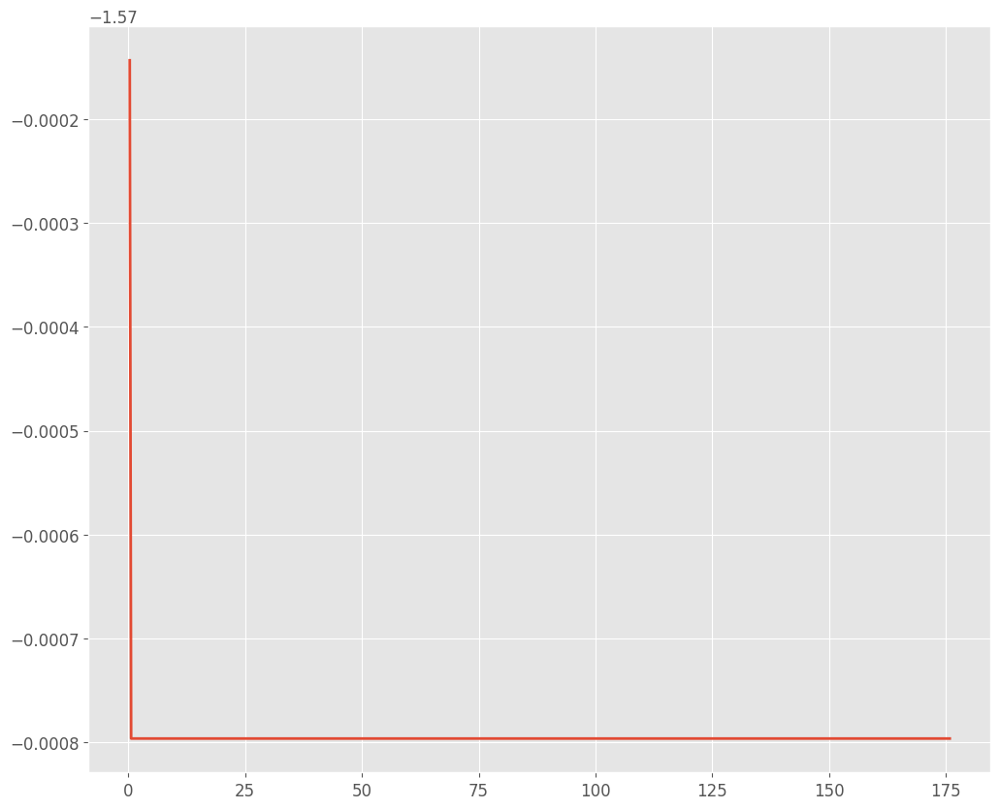

In [29]:
plt.plot(st[:,0],st[:,-1])

# BARD

In [6]:
import numpy as np
from scipy.integrate import odeint

# Constants and parameters
G = 6.6743e-11  # m^3 kg^-1 s^-2 (gravitational constant)
MARS_MASS = 6.4171e23  # kg (mass of Mars)
MARS_RADIUS = 3389.5  # km (radius of Mars)
ATMO_MODEL = ...  # Replace with appropriate atmospheric model function

# Vehicle parameters
MASS = 1000  # kg (mass of spacecraft)
DRAG_COEF = 1.2  # dimensionless drag coefficient
LIFT_COEF_MAX = 0.5  # maximum lift coefficient
PARACHUTE_AREA = 100  # m^2 (parachute area)
PARACHUTE_DRAG_COEF = 2.5  # parachute drag coefficient

# Control system parameters
KP = 2  # proportional gain for guidance
KI = 0.1  # integral gain for guidance
KP_LANDING = 10  # proportional gain for landing control

# Initial state
state = np.array([
    10000,  # km (initial position)
    5000,
    0,
    -5000,  # km/s (initial velocity)
    2000,
    0,
    0,  # km (initial target position)
    0,
    0,
    False,  # parachute deployed flag
    0  # landing altitude trigger
])

# Stage functions
def pre_entry_phase(state):
    # Orbit determination, trajectory planning, attitude maneuver, heat shield deployment
    # ... (replace with mission-specific logic)
    return state, True  # Return updated state and flag to proceed

def entry_phase(state):
    # Atmospheric interface detection
    if detect_atmospheric_interface(state):
        # Aerodynamic deceleration, bank angle control, navigation and correction
        guidance_output = guidance(state)
        lift_angle, bank_angle = control_lift_and_bank(guidance_output)
        state_derivatives = state_derivatives_entry(state, lift_angle, bank_angle)
        return odeint(state_derivatives, state, t_entry), True
    else:
        return state, False  # Remain in pre-entry phase

def terminal_descent_phase(state):
    # Parachute deployment, drogue chute stabilization, main chute descent
    if state[9] and state[2] < state[11]:  # Check parachute deployed and below trigger altitude
        # Guide descent trajectory, terrain relative navigation, precision landing guidance
        guidance_output = guidance_landing(state)
        thrust_command = control_thrust_landing(guidance_output)
        state_derivatives = state_derivatives_landing(state, thrust_command)
        return odeint(state_derivatives, state, t_landing), True
    else:
        return state, False  # Remain in entry phase or wait for deployment trigger

def landing_phase(state):
    # Touchdown maneuver, post-landing stabilization, instrument deployment
    if state[2] <= 0:  # Check for touchdown
        # Execute touchdown maneuver and post-landing stabilization
        # ... (replace with mission-specific logic)
        return state, True
    else:
        return state, False  # Continue landing phase

# Control and guidance functions
def guidance(state):
    # ... (replace with actual guidance algorithm)
    return np.zeros(3)  # Placeholder for guidance output

def control_lift_and_bank(guidance_output):
    # ... (replace with actual control logic for lift and bank angle)
    return 0, 0  # Placeholders for lift and bank angles

def control_thrust_landing(guidance_output):
    # ... (replace with actual control logic for thrust during landing)
    return 0  # Placeholder for thrust command

# State derivative functions
def state_derivatives_entry(state, lift_angle, bank_angle):
    # ... (replace with detailed state derivatives considering atmosphere, lift, and drag)
    return np.zeros(12)  # Placeholder for state derivatives


def state_derivatives_landing(state, thrust_command):
    position, velocity, target, _, _, _, _, _, _, parachute_deployed, _ = state
    r = np.linalg.norm(position)
    unit_r = position / r
    gravity = G * MARS_MASS / r**2
    drag = -0.5 * ATMO_MODEL(r) * PARACHUTE_DRAG_COEF * np.linalg.norm(velocity)**2 * velocity
    lift = 0  # No aerodynamic lift during landing
    thrust = np.array([0, 0, thrust_command])  # Thrust in vertical direction
    acceleration = gravity + drag + thrust
    # Add equations for target position tracking and control here (replace with guidance logic)
    # ...
    return np.concatenate([velocity, acceleration, np.zeros(9)])


In [ ]:
def state_derivatives_landing(state, thrust_command):
    position, velocity, target, _, _, _, _, _, _, parachute_deployed, landing_altitude_trigger = state
    r = np.linalg.norm(position)
    unit_r = position / r
    gravity = G * MARS_MASS / r**2

    # Calculate atmospheric density with a more accurate atmospheric model
    atmosphere_density = atmospheric_model(r)

    # Consider both parachute and vehicle drag based on their respective areas and drag coefficients
    parachute_drag = -0.5 * atmosphere_density * PARACHUTE_AREA * PARACHUTE_DRAG_COEF * np.linalg.norm(velocity)**2 * velocity
    vehicle_drag = -0.5 * atmosphere_density * DRAG_COEF * np.linalg.norm(velocity)**2 * velocity * unit_r
    drag = parachute_drag + vehicle_drag

    # Calculate lift based on descent angle and lift coefficient (limited by angle of attack)
    lift_angle = np.arctan2(thrust_command, np.linalg.norm(velocity))  # Assume thrust points towards target
    lift_coefficient = min(LIFT_COEF_MAX, abs(lift_angle)) * np.sign(lift_angle)
    lift = 0.5 * atmosphere_density * MASS * lift_coefficient * np.array([-lift_angle, 1])

    # Add thrust force
    thrust = np.array([0, 0, thrust_command])

    # Include horizontal position control based on guidance (replace with your chosen guidance logic)
    # ... (e.g., proportional control law based on position error)

    acceleration = gravity + drag + lift + thrust

    # Update state based on landing phase:
    # - If parachute deployed and below trigger altitude, update landing phase state derivatives
    # - If not deployed or above trigger altitude, maintain current state
    if parachute_deployed and r < landing_altitude_trigger:
        return np.concatenate([velocity, acceleration, np.zeros(9)])
    else:
        return np.zeros(12)  # Maintain current state if not in landing phase
